In [ ]:
!nvidia-smi

Sat Jun 20 22:16:16 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.36.06    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   65C    P8    11W /  70W |      0MiB / 15079MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
!pip install gdown
!pip install tensorflow-gpu

     |████████████████████████████████| 516.2MB 31kB/s 


In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
import pandas as pd
import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt
from matplotlib import rc
from pandas.plotting import register_matplotlib_converters

%matplotlib inline
%config InlineBackend.figure_format='retina'

register_matplotlib_converters()
sns.set(style='whitegrid', palette='muted', font_scale=1.5)

rcParams['figure.figsize'] = 22, 10


RANDOM_SEED = 42

np.random.seed(RANDOM_SEED)
tf.random.set_seed(RANDOM_SEED)

In [ ]:
import pandas as pd
from google.colab import files

In [ ]:
uploaded = files.upload()

Saving 2018.csv to 2018 (1).csv


In [ ]:
for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

User uploaded file "2018.csv" with length 16318212 bytes


In [ ]:
uploaded

{'2018.csv': b'FL_DATE,ACTUAL_ELAPSED_TIME\r\n01/01/2018,250\r\n02/01/2018,83\r\n03/01/2018,126\r\n04/01/2018,182\r\n05/01/2018,106\r\n06/01/2018,79\r\n07/01/2018,193\r\n08/01/2018,102\r\n09/01/2018,299\r\n10/01/2018,237\r\n11/01/2018,296\r\n12/01/2018,80\r\n13/01/2018,347\r\n14/01/2018,140\r\n15/01/2018,118\r\n16/01/2018,338\r\n17/01/2018,339\r\n18/01/2018,149\r\n19/01/2018,206\r\n20/01/2018,92\r\n21/01/2018,131\r\n22/01/2018,213\r\n23/01/2018,189\r\n24/01/2018,325\r\n25/01/2018,262\r\n26/01/2018,371\r\n27/01/2018,184\r\n28/01/2018,150\r\n29/01/2018,175\r\n30/01/2018,357\r\n31/01/2018,237\r\n01/02/2018,51\r\n02/02/2018,238\r\n03/02/2018,352\r\n04/02/2018,128\r\n05/02/2018,192\r\n06/02/2018,169\r\n07/02/2018,127\r\n08/02/2018,146\r\n09/02/2018,200\r\n10/02/2018,189\r\n11/02/2018,249\r\n12/02/2018,157\r\n13/02/2018,213\r\n14/02/2018,233\r\n15/02/2018,158\r\n16/02/2018,92\r\n17/02/2018,165\r\n18/02/2018,68\r\n19/02/2018,199\r\n20/02/2018,293\r\n21/02/2018,81\r\n22/02/2018,122\r\n23/02/20

In [ ]:
import pandas as pd
import io
df = pd.read_csv(io.StringIO(uploaded['2018.csv'].decode('utf-8')),parse_dates=['FL_DATE'], index_col='FL_DATE')
print(df)


            ACTUAL_ELAPSED_TIME
FL_DATE                        
2018-01-01                250.0
2018-02-01                 83.0
2018-03-01                126.0
2018-04-01                182.0
2018-05-01                106.0
...                         ...
2018-02-26                105.0
2018-02-26                109.0
2018-02-26                112.0
2018-02-26                153.0
2018-02-26                 94.0

[1048575 rows x 1 columns]


In [ ]:
df

,ACTUAL_ELAPSED_TIME
FL_DATE,
2018-01-01,250.0
2018-02-01,83.0
2018-03-01,126.0
2018-04-01,182.0
2018-05-01,106.0
...,...
2018-02-26,105.0
2018-02-26,109.0
2018-02-26,112.0


In [ ]:
df.isnull().sum()

ACTUAL_ELAPSED_TIME    28490
dtype: int64

In [ ]:
df = df.replace(np.nan, 0)

In [ ]:

df.shape

(1048575, 1)

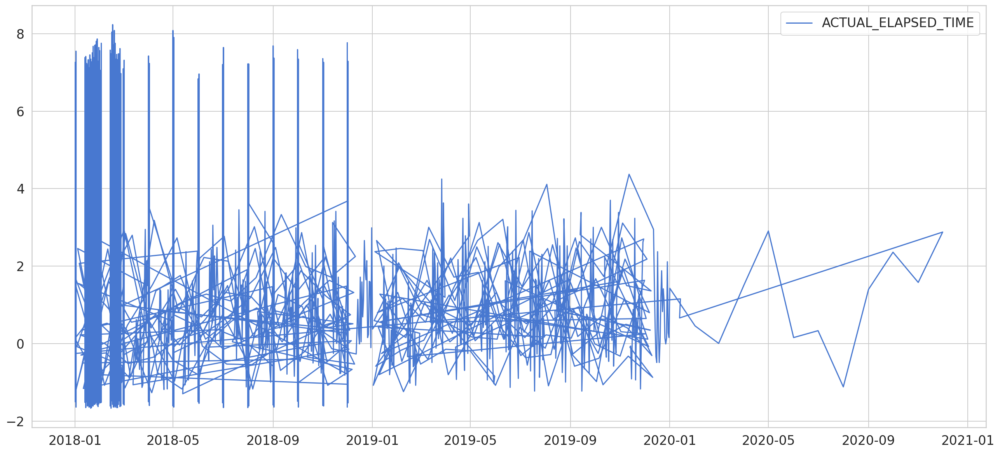

In [ ]:
plt.plot(df, label='ACTUAL_ELAPSED_TIME')
plt.legend();

In [ ]:
train_size = int(len(df) * 0.95)
test_size = len(df) - train_size
train, test = df.iloc[0:train_size], df.iloc[train_size:len(df)]
print(train.shape, test.shape)

(996146, 1) (52429, 1)


In [ ]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaler = scaler.fit(train[['ACTUAL_ELAPSED_TIME']])

train['ACTUAL_ELAPSED_TIME'] = scaler.transform(train[['ACTUAL_ELAPSED_TIME']])
test['ACTUAL_ELAPSED_TIME'] = scaler.transform(test[['ACTUAL_ELAPSED_TIME']])

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


In [ ]:
train.head()

,ACTUAL_ELAPSED_TIME
FL_DATE,
2018-01-01,1.563626
2018-02-01,-0.752408
2018-03-01,-0.156064
2018-04-01,0.620571
2018-05-01,-0.433433


In [ ]:
def create_dataset(X, y, time_steps=1):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        v = X.iloc[i:(i + time_steps)].values
        Xs.append(v)        
        ys.append(y.iloc[i + time_steps])
    return np.array(Xs), np.array(ys)

In [ ]:
TIME_STEPS = 3

# reshape to [samples, time_steps, n_features]

X_train, y_train = create_dataset(train[['ACTUAL_ELAPSED_TIME']], train.ACTUAL_ELAPSED_TIME, TIME_STEPS)
X_test, y_test = create_dataset(test[['ACTUAL_ELAPSED_TIME']], test.ACTUAL_ELAPSED_TIME, TIME_STEPS)

print(X_train.shape)

(996143, 3, 1)


In [ ]:
X_train.shape

(996143, 3, 1)

In [ ]:
#LSTM AUTOENCODER
model = keras.Sequential()
model.add(keras.layers.LSTM(
    units=64, 
    input_shape=(X_train.shape[1], X_train.shape[2])
))
model.add(keras.layers.Dropout(rate=0.2))
model.add(keras.layers.RepeatVector(n=X_train.shape[1]))
model.add(keras.layers.LSTM(units=64, return_sequences=True))
model.add(keras.layers.Dropout(rate=0.2))
model.add(keras.layers.TimeDistributed(keras.layers.Dense(units=X_train.shape[2])))
model.compile(loss='mae', optimizer='adam')

In [ ]:
history = model.fit(
    X_train, y_train,
    epochs=10,
    batch_size=32,
    validation_split=0.1,
    shuffle=False
)

Epoch 1/10
28017/28017 [==============================] - 183s 7ms/step - loss: 0.6028 - val_loss: 0.6178
Epoch 2/10
28017/28017 [==============================] - 182s 7ms/step - loss: 0.5980 - val_loss: 0.6156
Epoch 3/10
28017/28017 [==============================] - 184s 7ms/step - loss: 0.5967 - val_loss: 0.6136
Epoch 4/10
28017/28017 [==============================] - 183s 7ms/step - loss: 0.5956 - val_loss: 0.6116
Epoch 5/10
28017/28017 [==============================] - 182s 7ms/step - loss: 0.5949 - val_loss: 0.6097
Epoch 6/10
28017/28017 [==============================] - 184s 7ms/step - loss: 0.5943 - val_loss: 0.6081
Epoch 7/10
28017/28017 [==============================] - 181s 6ms/step - loss: 0.5938 - val_loss: 0.6066
Epoch 8/10
28017/28017 [==============================] - 185s 7ms/step - loss: 0.5936 - val_loss: 0.6064
Epoch 9/10
28017/28017 [==============================] - 183s 7ms/step - loss: 0.5932 - val_loss: 0.6065
Epoch 10/10
28017/28017 [=====================

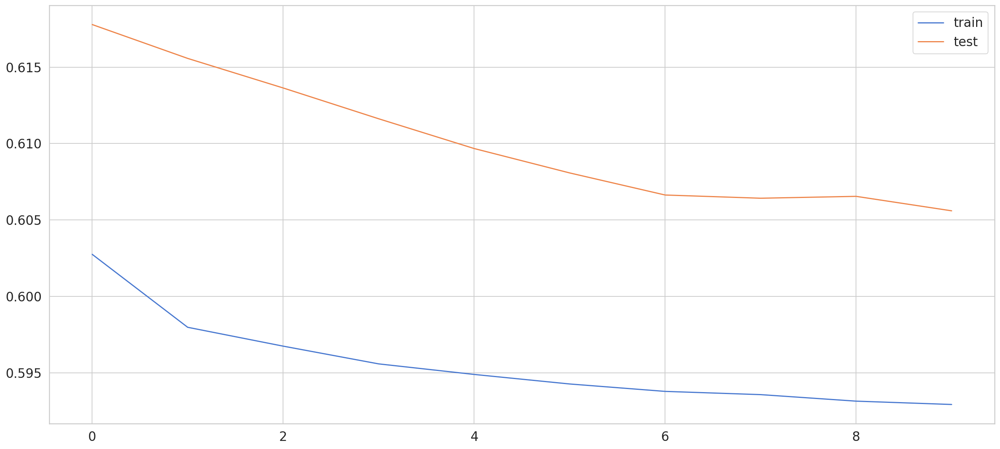

In [ ]:
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend();

In [ ]:
X_train_pred = model.predict(X_train)

train_mae_loss = np.mean(np.abs(X_train_pred - X_train), axis=1)

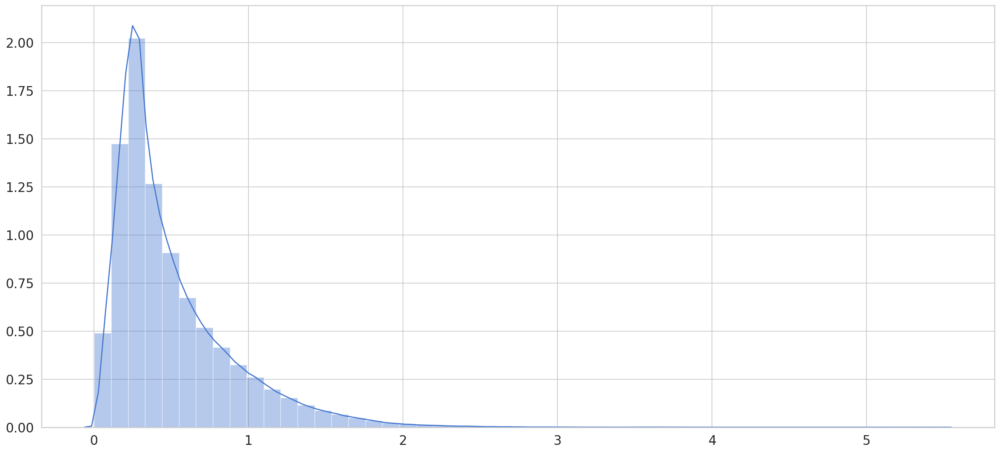

In [ ]:
sns.distplot(train_mae_loss, bins=50, kde=True);

In [ ]:
X_test_pred = model.predict(X_test)

test_mae_loss = np.mean(np.abs(X_test_pred - X_test), axis=1)

In [ ]:
THRESHOLD = 0.6

test_score_df = pd.DataFrame(index=test[TIME_STEPS:].index)
test_score_df['loss'] = test_mae_loss
test_score_df['threshold'] = THRESHOLD
test_score_df['anomaly'] = test_score_df.loss > test_score_df.threshold
test_score_df['ACTUAL_ELAPSED_TIME'] = test[TIME_STEPS:].ACTUAL_ELAPSED_TIME

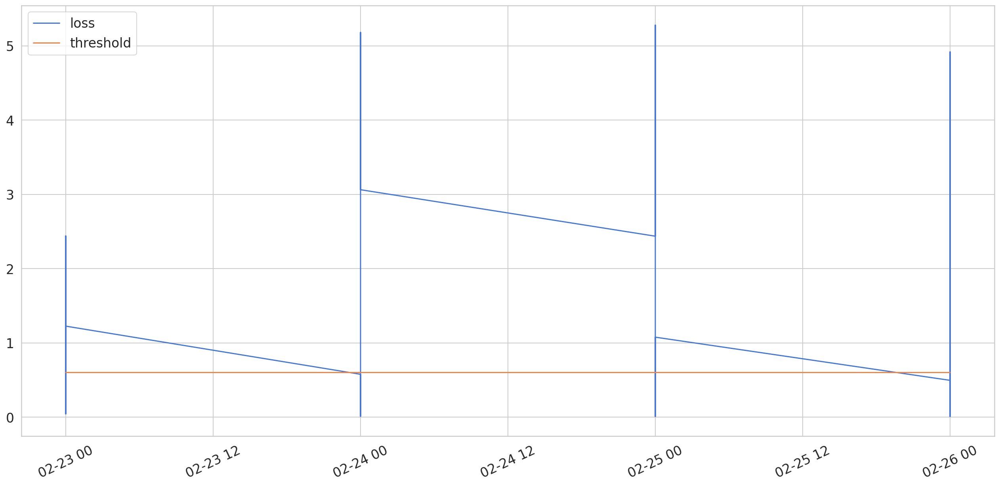

In [ ]:
plt.plot(test_score_df.index, test_score_df.loss, label='loss')
plt.plot(test_score_df.index, test_score_df.threshold, label='threshold')
plt.xticks(rotation=25)
plt.legend();

In [ ]:
anomalies = test_score_df[test_score_df.anomaly == True]
anomalies.head()

,loss,threshold,anomaly,ACTUAL_ELAPSED_TIME
FL_DATE,,,,
2018-02-23,1.030418,0.6,True,2.312524
2018-02-23,1.234515,0.6,True,-1.182331
2018-02-23,2.105767,0.6,True,-0.821750
2018-02-23,1.372353,0.6,True,1.854864
2018-02-23,1.343039,0.6,True,-0.655329


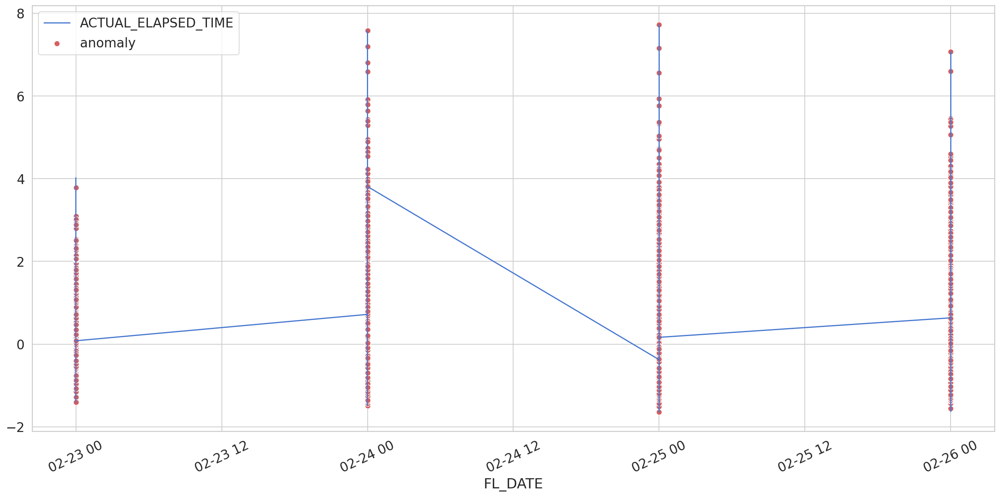

In [ ]:


plt.plot(
  test[TIME_STEPS:].index, 
  scaler.inverse_transform(test[TIME_STEPS:].ACTUAL_ELAPSED_TIME), 
  label='ACTUAL_ELAPSED_TIME'
);

sns.scatterplot(
  anomalies.index,
  scaler.inverse_transform(anomalies.ACTUAL_ELAPSED_TIME),
  color=sns.color_palette()[3],
  s=52,
  label='anomaly'
)
plt.xticks(rotation=25)
plt.legend();